# Home Assignment No. 2: Part 2 (Practice)
To solve this task, you will write a lot of code to try several deep learning methods.
* You are **HIGHLY RECOMMENDED** to read relevant documentation, e.g. for [python](https://docs.python.org/3/), [numpy](https://docs.scipy.org/doc/numpy/reference/), [matlpotlib](https://matplotlib.org/) and [pytorch](https://pytorch.org/). Also remember that seminars, lecture slides, [Google](http://google.com) and [StackOverflow](https://stackoverflow.com/) are your close friends during this course (and, probably, whole life?).

* To do this part of homework, you have to write **CODE** directly inside specified places inside notebook **CELLS**.

* In some problems you may be asked to provide short discussion of the results. In this cases you have to create **MARKDOWN** cell with your comments right after the your code cell.

* For every separate (sub)problem you can get only 0 points or maximal points for this (sub)problem. There are **NO INTERMEDIATE scores**. So make sure that you did everything required in the task

* Your **SOLUTION** notebook **MUST BE REPRODUCIBLE**, i.e. if the reviewer decides to execute `Kernel` -> `Restart Kernel and Run All Cells`, after all the computation he will obtain exactly the same solution (with all the corresponding plots) as in your uploaded notebook. For this purpose, we suggest to fix random `seed` or (better) define `random_state=` inside every algorithm that uses some pseudorandomness.

* Your code must be clear to the reviewer. For this purpose, try to include neccessary comments inside the code. But remember: **GOOD CODE MUST BE SELF-EXPLANATORY** without any additional comments.

## Task 1. Deep ANNs. (5 points)

### Task 1.1.  Activation functions. (1 point)
Plot the following [activation functions](https://pytorch.org/docs/master/nn.html#non-linear-activation-functions) using their PyTorch realizations and their derivatives using [autograd](https://pytorch.org/docs/stable/autograd.html) functionality `grad()`:
   
1. **(1 pt.)** Plot `ReLU`, `ELU` ($\alpha = 1$), `Softplus` ($\beta = 1$) and `Sign`, `Sigmoid`, `Softsign`, `Tanh`.
Which of these functions may be, and which - definitely, are a poor choise as an activation function in a neural network? Why?

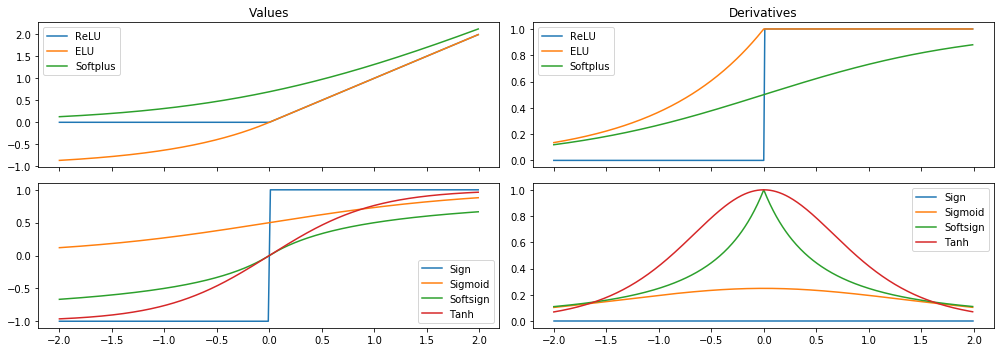

In [0]:
%matplotlib inline
import torch.nn.functional as F
import matplotlib.pyplot as plt
import torch

x = torch.arange(-2, 2, .01, requires_grad=True)
x_np = x.detach().numpy()
x.sum().backward() # to create x.grad

f, axes = plt.subplots(2, 2, sharex=True, figsize=(14, 5))
axes[0, 0].set_title('Values')
axes[0, 1].set_title('Derivatives')
for i, function_set in (0, (('ReLU', F.relu), ('ELU', F.elu), ('Softplus', F.softplus))), \
                       (1, (('Sign', torch.sign), ('Sigmoid', torch.sigmoid), ('Softsign', F.softsign), ('Tanh', torch.tanh))):
    for function_name, activation in function_set:
        ### BEGIN Solution
        x.grad.zero_()
        xs = x.detach().numpy()
        f_values = activation(x).data.numpy()
        activation(x).sum().backward()
        d_values = x.grad.data.numpy()
        axes[i, 0].plot(xs, f_values, label = function_name)
        axes[i, 1].plot(xs, d_values , label=function_name)      
        ### END Solution
    axes[i, 0].legend()
    axes[i, 1].legend()
plt.tight_layout()
plt.show()

- The **sign function**, has a problem in getting derivative at zero point, it does not recount values in backpropagation process and it gives no correction. Therefore, It is not useful in backpropagation. It is a poor choice in Neural Network 


- For **Relu** ,it pose a problem in calculating gradients for negative values when use in backpropagation. it is also a poor choice as well.



### Task 1.2. MNIST classification. (4 points)

At the **[Seminar 13](https://github.com/adasegroup/ML2020_seminars/tree/master/seminar12)** on neural networks, we designed an MLP (Multilayer perceptron) with one hidden layer using our numpy implementations of linear layer, logistic and softmax activation functions. In this task, you are to

1. **(1 pt.)** Implement the MLP modules, including the Softmax cross entropy between `logits` and `labels`.
2. **(2 pt.)** Train our numpy realization of MLP to classify the MNIST from `sklearn.datasets()`. The required accuracy on validation is `> 90%`.
3. **(1 pt.)** Compare the acccuracy of classification to your scores from `Part 1` with and without dimensionality reduction. Is this comparison fair? :) Derive the confusion matrix for all digits classes. Which digits are predicted better or worse than others?

In [0]:
from sklearn.metrics import confusion_matrix, accuracy_score
from sklearn.datasets import load_digits
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [0]:
# fetch the dataset.
digits, targets = load_digits(return_X_y=True)
digits = digits.astype(np.float32) / 255

digits_train, digits_test, targets_train, targets_test = train_test_split(digits, targets, random_state=0)
train_size = digits_train.shape[0]

input_size = 8*8
classes_n = 10

**Implement the MLP with backprop.**

In [0]:
class Linear:
    def __init__(self, input_size, output_size):
        self.thetas = np.random.randn(input_size, output_size)
        self.thetas_grads = np.empty_like(self.thetas)
        self.bias = np.random.randn(output_size)
        self.bias_grads = np.empty_like(self.bias)
        self.input = 0 

    def forward(self, x):
        self.input = x
        output = np.matmul(x, self.thetas) + self.bias
        return output

    def backward(self, x, output_grad):
        ### BEGIN Solution
        # ... calculate grads
        input_grad = np.matmul(self.thetas,output_grad)
        self.thetas_grads += np.matmul(self.input.reshape(-1,1) ,output_grad.reshape(-1,1).T)
        self.bias_grads += output_grad.sum(axis=0)
        ### END Solution
        return input_grad

class LogisticActivation:
    def __init__(self):
        self.input = 0        
    def forward(self, x):
        self.input = x
        output = 1/(1 + np.exp(-x))
        return output
    def backward(self, x, output_grad):
        ### BEGIN Solution
        # ... calculate grads
        output = self.forward(self.input)
        input_grad = output_grad*output*(1-output)
        ### END Solution
        return input_grad
    
class SoftMaxActivation:
    def __init__(self):
        self.input = 0    
    def forward(self, x):
        self.input = x
        output = np.exp(x) / np.exp(x).sum(axis=-1, keepdims=True)
        return output
    def backward(self, x, output_grad):
        ### BEGIN Solution
        # ... calculate grads
        output = self.forward(self.input)
        input_grad = output_grad*output*(1-output)
        ### END Solution
        return input_grad
    
class MLP:
    def __init__(self, input_size, hidden_layer_size, output_size):
        self.linear1 = Linear(input_size, hidden_layer_size)
        self.activation1 = LogisticActivation()
        self.linear2 = Linear(hidden_layer_size, output_size)
        self.softmax = SoftMaxActivation()
        
    def forward(self, x):
        return self.softmax.forward(self.linear2.forward(self.activation1.forward(self.linear1.forward(x))))


    def backward(self, x, output_grad):
        ### BEGIN Solution
        lin_input_grad = self.linear2.backward(x, output_grad)
        log_input_grad = self.activation1.backward(x, lin_input_grad)
        output_grad = self.linear1.backward(x, log_input_grad)
        ### END Solution

In [0]:
# ### BEGIN Solution
def softmax_crossentropy_with_logits(logits, reference_answers): 
    
    if logits.ndim == 1 :
        cross = -np.log(logits)[reference_answers]    
    else:
        entropy = np.zeros_like(logits)
        entropy[np.arange(len(reference_answers)), reference_answers] = 1
        cross = -np.sum(entropy * np.log(logits), axis=1)
    return cross

def grad_softmax_crossentropy_with_logits(logits,reference_answers):
    entropy = np.zeros_like(logits)
    entropy[reference_answers] = 1 
    grad_cross =  (-entropy+logits) 
    return grad_cross


  ## END Solution

In [0]:
np.random.seed(42)
mlp = MLP(input_size=input_size, hidden_layer_size=100, output_size=classes_n)
epochs_n = 100
learning_curve = [0] * epochs_n
test_curve = [0] * epochs_n
x_train = digits_train
x_test = digits_test
y_train = targets_train
y_test = targets_test
learning_rate = 1e-2
for epoch in range(epochs_n):
        
    for sample_i in range(train_size):
        x = x_train[sample_i]
        #target = np.array([y_train[sample_i]])
        target = y_train[sample_i]
        ### BEGIN Solution
        # ... zero the gradients of the model
        # ... perform forward pass and compute the loss
        # >>> your solution here <<<

        mlp.linear1.thetas_grads = np.zeros_like(mlp.linear1.thetas_grads)
        mlp.linear1.bias_grads = np.zeros_like(mlp.linear1.bias_grads)
        mlp.linear2.thetas_grads = np.zeros_like(mlp.linear2.thetas_grads)
        mlp.linear2.bias_grads = np.zeros_like(mlp.linear2.bias_grads)      
        prediction = mlp.forward(x)
        loss = softmax_crossentropy_with_logits(prediction, target)
        loss_grad = grad_softmax_crossentropy_with_logits(prediction, target)
        learning_curve[epoch] += loss
        grad = mlp.backward(x, loss_grad)

        # ... compute the gradients w.r.t. the input of softmax layer
        # ... perform backward pass
        # ... and update the weights with weight -= grad * learning_rate
        
        # >>> your solution here <<<

        mlp.linear1.thetas -= learning_rate * mlp.linear1.thetas_grads
        mlp.linear1.bias -= learning_rate * mlp.linear1.bias_grads
        mlp.linear2.thetas -= learning_rate * mlp.linear2.thetas_grads
        mlp.linear2.bias -= learning_rate * mlp.linear2.bias_grads
        #pred_ = np.argmax(mlp.forward(x.reshape((1, -1))), -1)
        #acc = accuracy_score(targets,prediction)

    test_size = digits_test.shape[0]
    acc = 0
    for sample_i in range(test_size):
      x = x_test[sample_i].reshape((1,-1))
      target_test = y_test[sample_i]
      test_ = mlp.forward(x)
      if test_.argmax() == target_test:
        acc += 1
    acc/=test_size
 
    

    learning_curve[epoch] /= train_size
    prediction = mlp.forward(x_test)
    loss = softmax_crossentropy_with_logits(prediction, y_test).mean()
    test_curve[epoch] = loss
    if epoch % 10 == 0:
        print('Starting epoch {}'.format(epoch),', Accuracy on test: ',acc )
        print()
        
    ### END Solution

Starting epoch 0 , Accuracy on test:  0.1111111111111111

Starting epoch 10 , Accuracy on test:  0.64

Starting epoch 20 , Accuracy on test:  0.8066666666666666

Starting epoch 30 , Accuracy on test:  0.86

Starting epoch 40 , Accuracy on test:  0.8844444444444445

Starting epoch 50 , Accuracy on test:  0.9088888888888889

Starting epoch 60 , Accuracy on test:  0.92

Starting epoch 70 , Accuracy on test:  0.9222222222222223

Starting epoch 80 , Accuracy on test:  0.9244444444444444

Starting epoch 90 , Accuracy on test:  0.9244444444444444



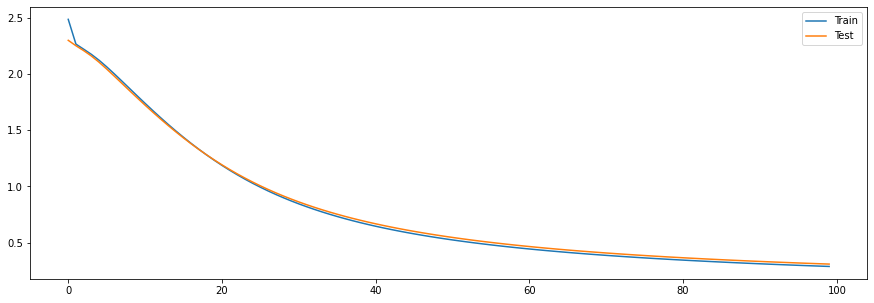

In [0]:
plt.figure(figsize=(15,5))
plt.plot(learning_curve, label = 'Train')
plt.plot(test_curve,label =  'Test')
plt.legend()

In [0]:
pred_ = np.argmax(mlp.forward(digits), -1)
pred_
acc = accuracy_score(targets,pred_)
acc

0.9376739009460211

- Compare the acccuracy of classification to your scores from Part 1 with and without dimensionality reduction.

- The accuracy from part 1(using ISOMAP-- **97%**) is higher than the one gotten using here using MLP 

- this is not a fair comparison, dimentionality reduction process has given the procedure in part-1 a upper hand over MLP

  - Derive the confusion matrix for all digits classes. Which digits are predicted better or worse than others?

In [0]:
#pred_ = np.argmax(mlp.forward(digits), axis=1)
pd.DataFrame(confusion_matrix(targets, pred_))

,0,1,2,3,4,5,6,7,8,9
0,176,0,0,0,1,0,1,0,0,0
1,0,160,4,0,0,0,2,0,4,12
2,0,4,170,2,0,0,0,1,0,0
3,0,1,4,171,0,2,0,3,1,1
4,0,0,0,0,176,0,0,4,0,1
5,0,0,0,0,1,172,1,0,0,8
6,1,2,0,0,1,0,177,0,0,0
7,0,0,0,0,0,0,0,178,0,1
8,0,14,2,1,1,4,1,3,145,3
9,0,2,0,6,2,3,0,4,3,160


- As shown from the Confusion Matrix above, 

- Digit **7** was predicted best

- and digit **8** was predicted worse

## Task 2. Autoencoders. (7 points)

### Task 2.1.  Autoencoder on the tabular data. (3 points)


We will build a latent representation for tabular data with simple Autoencoder (AE). We are going to work with the cancer dataset from scikit-learn package. You are to follow the instructions `1.0 - 1.6`.  

1. **(1 pt.)** Implement AE modules;
2. **(2 pt.)** Train AE to get latent representation of the cancer dataset from `sklearn.datasets()`. Use `MSE` loss and get < $0.28$ on validation, with AE "bottleneck" = $2$;
3. **(1 pt.)** Plot the latent representation of whole dataset in 2D, use colors to show object of differneet classes;

In [0]:
# imports
import sklearn.datasets as sk_data
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler

import torch
import torch.nn as nn
import torch.utils.data as torch_data

#### 1.0 Featch the data. Scale it and split on train and test.

In [0]:
cancer_dset = sk_data.load_breast_cancer()

X = StandardScaler().fit_transform(cancer_dset['data'])

print('Features: ', list(cancer_dset['feature_names']))
print('\nShape:', X.shape)

X_train, X_val, y_train, y_val = train_test_split(X, cancer_dset['target'], test_size=0.2, random_state=42)
print('\nTrain size: ', len(X_train))
print('Validation size: ', len(X_val))

Features:  ['mean radius', 'mean texture', 'mean perimeter', 'mean area', 'mean smoothness', 'mean compactness', 'mean concavity', 'mean concave points', 'mean symmetry', 'mean fractal dimension', 'radius error', 'texture error', 'perimeter error', 'area error', 'smoothness error', 'compactness error', 'concavity error', 'concave points error', 'symmetry error', 'fractal dimension error', 'worst radius', 'worst texture', 'worst perimeter', 'worst area', 'worst smoothness', 'worst compactness', 'worst concavity', 'worst concave points', 'worst symmetry', 'worst fractal dimension']

Shape: (569, 30)

Train size:  455
Validation size:  114


#### 1.1 Let us firtly create the dataset, which we'll be able to use with pytorch dataloader. 
Implement `__len__` and `__getitem__` methods.

In [0]:
class CancerData(torch_data.Dataset):
    def __init__(self, X, y):
        super(CancerData, self).__init__()
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.float32)
    
    def __len__(self):
        return len(self.X) # >>> your solution here <<<
    
    def __getitem__(self, idx):
        return (self.X[idx],self.y[idx])   # >>> your solution here <<<

In [0]:
train_dset = CancerData(X_train, y_train) 
val_dset = CancerData(X_val, y_val) 

print(train_dset[5])

(tensor([ 0.1172,  1.9199,  0.1961,  0.0111,  1.2482,  1.0453,  0.9429,  0.6376,
         1.7940,  1.1302, -0.1269, -0.3336,  0.0064, -0.1713, -0.4780,  0.9458,
         0.5145, -0.1454, -0.2388,  0.6321,  0.2466,  1.8650,  0.5016,  0.1101,
         1.5532,  2.5664,  2.0649,  0.8617,  2.1310,  2.7793]), tensor(0.))


#### 1.2 Now, we'll make a base class for our autoencoder. 
AE takes as input encoder and decoder (it will be two neural networks). Your task is to implement the forward pass.

In [0]:
class MyFirstAE(nn.Module):
    def __init__(self, encoder, decoder):
        super(MyFirstAE, self).__init__()
        self.encoder = encoder
        self.decoder = decoder
    
    def forward(self, x):
        """
        Take a mini-batch as an input, encode it to the latent space and decode back to the original space
        x_out = decoder(encoder(x))
        :param x: torch.tensor, (MB, x_dim)
        :return: torch.tensor, (MB, x_dim)

        """
        en_x = self.encoder(x)
        x_out = self.decoder(en_x)
        return x_out # >>> your solution here <<<

#### 1.3 It is high time to create encoder an decoder neural networks!
Make hidden size of the network to be equal to `2`.

**Hint.** You can use `nn.Sequential` to create your own archtectures.

In [0]:
 # >>> your solution here <<<

samples, sample_size = X_train.shape

encoder = lambda hid: nn.Sequential(
                        nn.Linear(sample_size, 128*4),
                        nn.LeakyReLU(inplace=True),
                        nn.Linear(128*4,hid)
                                   )  

# >>> your solution here <<<
decoder = lambda hid: nn.Sequential(
                        nn.Linear(hid, 128*4),
                        nn.LeakyReLU(inplace=True), 
                        nn.Linear(128*4, sample_size), 
                        )

In [0]:
device = 'cpu' # >>> your solution here <<<

net = MyFirstAE(encoder(2),decoder(2))  
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net.parameters(), lr=1e-3)                           # >>> your solution here <<<
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.2)   # >>> your solution here <<<


train_loader = torch_data.DataLoader(train_dset, batch_size=25, shuffle=True) 
val_loader = torch_data.DataLoader(val_dset, batch_size=50, shuffle=False) 

#### 1.4 Implement the missing parts of the `train` function

In [0]:
def train(epochs, net, criterion, optimizer, train_loader, val_loader,scheduler=None, verbose=True, save_dir=None):
    net.to(device)
    for epoch in range(1, epochs+1):
        net.train()
        for X, _ in train_loader:
            # Perform one step of minibatch stochastic gradient descent
            # >>> your solution here <<<
            X = X.to(device)
            out = net(X)
            loss = criterion(out,X)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
        # define NN evaluation, i.e. turn off dropouts, batchnorms, etc.
        net.eval()
        for X, _ in val_loader:
            # Compute the validation loss
            # >>> your solution here <<<
            X = X.to(device)
            out = net(X)
            val_loss = criterion(out,X)
         
        if scheduler is not None:
            scheduler.step()
        freq = max(epochs//20,1)
        if verbose and epoch%freq==0:
            print('Epoch {}/{} || Loss:  Train {:.4f} | Validation {:.4f}'.format(epoch, epochs, loss.item(), val_loss.item()))

#### 1.5 Train your AE on breast cancer dataset. 
Your goal is to get validation error <0.3.

Some features that may help you to improve the performance:
* `Dropout`
* `Batchnorm`
* lr scheduler
* Batch size increase/decrease

In [0]:
# for `MSE` loss get < 0.28 on validation, with AE "bottleneck" = 2
train(100, net, criterion, optimizer, train_loader, val_loader, scheduler) 

Epoch 5/100 || Loss:  Train 0.2752 | Validation 0.2959
Epoch 10/100 || Loss:  Train 0.2959 | Validation 0.3186
Epoch 15/100 || Loss:  Train 0.5399 | Validation 0.3196
Epoch 20/100 || Loss:  Train 0.1561 | Validation 0.3149
Epoch 25/100 || Loss:  Train 0.2740 | Validation 0.3098
Epoch 30/100 || Loss:  Train 0.3207 | Validation 0.3232
Epoch 35/100 || Loss:  Train 0.1724 | Validation 0.2981
Epoch 40/100 || Loss:  Train 0.2531 | Validation 0.3021
Epoch 45/100 || Loss:  Train 0.1148 | Validation 0.2979
Epoch 50/100 || Loss:  Train 0.3041 | Validation 0.2919
Epoch 55/100 || Loss:  Train 0.3001 | Validation 0.2901
Epoch 60/100 || Loss:  Train 0.2545 | Validation 0.2883
Epoch 65/100 || Loss:  Train 0.3387 | Validation 0.2888
Epoch 70/100 || Loss:  Train 0.2382 | Validation 0.2867
Epoch 75/100 || Loss:  Train 0.4405 | Validation 0.2865
Epoch 80/100 || Loss:  Train 0.2693 | Validation 0.2863
Epoch 85/100 || Loss:  Train 0.2243 | Validation 0.2872
Epoch 90/100 || Loss:  Train 0.1594 | Validation 


#### 1.6 Let us take a look at the latent space. 
Encode the whole dataset, using your AE, plot it in 2D and use colors to indicate objects of differrent classes

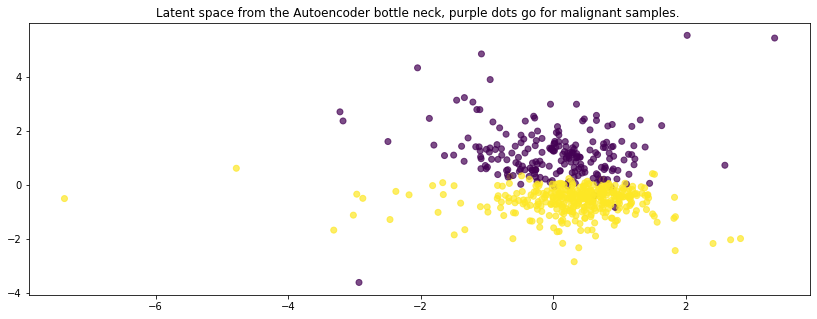

In [0]:
 ### BEGIN Solution
plt.figure(figsize=(14, 5))
net.eval()
enc = net.encoder(torch.Tensor(X)).to('cpu').detach().numpy()
#enc = net.encoder(X).detach().numpy()       # >>> your solution here <<<
plt.scatter(enc[:,0], enc[:,1], c=cancer_dset['target'], alpha=0.7);
plt.title('Latent space from the Autoencoder bottle neck, purple dots go for malignant samples. ');
 ### END Solution

### Task 2.2.  Autoencoder on kMNIST. (4 points)


We will build a latent representation for `kMRIST` dataset by using our AE. We will work with the data from `Part 1`.

1. **(2 pt.)** Train AE to get latent representation of the `kMNIST` dataset from `sklearn.datasets()`. Follow the instructions `2.0 - 2.4`. Use `MSE` loss and obtain < $0.035$ on validation, with AE "bottleneck"  $\leq 40$;
2. **(1 pt.)** Plot 10 images and their reconstructions. Plot the latent representation of the whole dataset in 3D, compare visually to your manifold from `Part 1` and upload (pictures) screenshots to this notebook.
3. **(1 pt.)** Get the classification accuracy for the latent features. Use the `KNN` classifier with any hyperparameters you like. Write a couple of sentences about the differences of `manifold learning` and ` AE` results. 
3. **(BONUS 3 pt.)** Sampling from latent representation.

In [0]:
import numpy as np
import matplotlib.pyplot as plt

In [0]:
def load(f):
    return np.load(f)['arr_0']
# Load the data
x_train = load('data/kmnist-train-imgs.npz')
x_test = load('data/kmnist-test-imgs.npz')
y_train = load('data/kmnist-train-labels.npz')
y_test = load('data/kmnist-test-labels.npz')

In [0]:
# Reshaping...
X_train = x_train.reshape(x_train.shape[0],-1)   # >>> your solution here <<<
X_test = x_test.reshape(x_test.shape[0],-1)      # >>> your solution here <<<

In [0]:
#Scaling,...
x_train = X_train/255     # >>> your solution here <<<
x_test =  X_test/255      # >>> your solution here <<<

In [0]:
x_train.shape

(60000, 784)

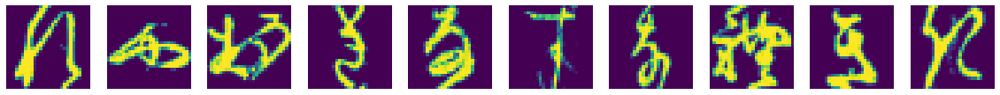

In [0]:
fig, ax = plt.subplots(ncols=10, figsize=(20, 5))
for i in range(10):
    ax[i].imshow(x_train[i].reshape(28,28));
    ax[i].axis('off')

In [0]:
class kMNISTData(torch_data.Dataset):
    def __init__(self, X, y):
        super(kMNISTData, self).__init__()
        self.X = torch.tensor(X, dtype=torch.float32)# >>> your solution here <<<                                                        
        self.y = torch.tensor(y, dtype=torch.float32)# >>> your solution here <<<
    
    def __len__(self):
        return len(self.y)# >>> your solution here <<<
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]# >>> your solution here <<<

In [0]:
train_kmnist = kMNISTData(x_train, y_train) ### YOUR CODE HERE ###
test_kmnist = kMNISTData(x_test, y_test) ### YOUR CODE HERE ###

In [0]:
test_kmnist

#### 2.0 Create encoder and decoder network for kMNIST. 
You can either use convolutions or flatten the images and use linear layers. You can choose hidden size (not larger than 40) and any architecture you like.

In [0]:
 # >>> your solution here <<<
s, s_size = x_train.shape
encoder = lambda hid: nn.Sequential(
                        nn.Linear(s_size, 128*4),
                        nn.LeakyReLU(inplace=True),
                        nn.Dropout(0.2),
                        nn.Linear(128*4, 128*2),
                        nn.LeakyReLU(inplace=True),
                        nn.Dropout(0.2),
                        nn.Linear(128*2, hid)
                        )  ### YOUR CODE HERE ###

decoder =  lambda hid: nn.Sequential(
                        nn.Linear(hid, 128*2),
                        nn.LeakyReLU(inplace=True),
                        nn.Dropout(0.2),
                        nn.Linear(128*2, 128*4),
                        nn.LeakyReLU(inplace=True),
                        nn.Dropout(0.2),
                        nn.Linear(128*4,s_size),
                        nn.Sigmoid(),
                        )

#### 2.1 Train AE on the kMNIST. 
Your goal is to obtain MSE on the test set < $0.035$ on `MyFirstAE(encoder(40), decoder(40))`.

In [0]:
device = torch.device('cuda:0') # >>> your solution here <<<
net = MyFirstAE(encoder(40), decoder(40))
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(net.parameters(), lr=1e-3)  ### YOUR CODE HERE ###
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.2)  ### YOUR CODE HERE ###
train_loader = torch_data.DataLoader(train_kmnist, batch_size=500, shuffle=True) 
val_loader = torch_data.DataLoader(test_kmnist, batch_size=500, shuffle=False) 

In [0]:
epochs = 100# >>> your solution here <<<
train(epochs, net, criterion, optimizer, train_loader, val_loader, scheduler)

Epoch 5/100 || Loss:  Train 0.0506 | Validation 0.0502
Epoch 10/100 || Loss:  Train 0.0450 | Validation 0.0419
Epoch 15/100 || Loss:  Train 0.0407 | Validation 0.0379
Epoch 20/100 || Loss:  Train 0.0396 | Validation 0.0360
Epoch 25/100 || Loss:  Train 0.0380 | Validation 0.0346
Epoch 30/100 || Loss:  Train 0.0367 | Validation 0.0336
Epoch 35/100 || Loss:  Train 0.0367 | Validation 0.0329
Epoch 40/100 || Loss:  Train 0.0369 | Validation 0.0320
Epoch 45/100 || Loss:  Train 0.0347 | Validation 0.0314
Epoch 50/100 || Loss:  Train 0.0359 | Validation 0.0310
Epoch 55/100 || Loss:  Train 0.0343 | Validation 0.0301
Epoch 60/100 || Loss:  Train 0.0347 | Validation 0.0299
Epoch 65/100 || Loss:  Train 0.0355 | Validation 0.0299
Epoch 70/100 || Loss:  Train 0.0337 | Validation 0.0297
Epoch 75/100 || Loss:  Train 0.0343 | Validation 0.0296
Epoch 80/100 || Loss:  Train 0.0339 | Validation 0.0295
Epoch 85/100 || Loss:  Train 0.0339 | Validation 0.0294
Epoch 90/100 || Loss:  Train 0.0341 | Validation 

#### 2.2 Plot any 10 images and their reconstructions.

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  """


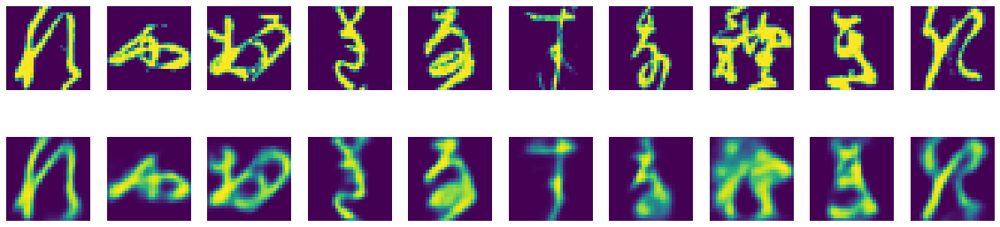

In [0]:
fig, ax = plt.subplots(ncols=10, nrows=2, figsize=(20, 5))
for i in range(10):
    im = train_kmnist[i][0].reshape(-1)
    # >>> your solution here <<<
    rec = net.forward(torch.tensor(im.detach(),dtype=torch.float32).detach().to('cuda')).detach().to('cpu').detach()
    ax[0, i].imshow(im.reshape(28,28));
    # >>> your solution here <<<
    ax[1, i].imshow(rec.reshape(28,28))   
    ax[0, i].axis('off')
    ax[1, i].axis('off')

#### 2.3 Plot the latent representation of whole dataset in 3D, compare visually to your manifold from `Part 1` and upload (pictures) screenshoots to this notebook.

In [0]:
### BEGIN Solution
# >>> your solution here <<<
import pandas as pd
from sklearn.decomposition import PCA

In [0]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))  

import plotly        
import IPython
IPython.get_ipython().events.register('pre_run_cell', configure_plotly_browser_state)
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import colorlover as cl
init_notebook_mode(connected=True)

In [0]:
data = np.concatenate((x_train,x_test),axis= 0)
data = torch.tensor(data,dtype=torch.float32)
df = net.encoder(data.reshape(-1,28*28).to(device)).cpu().detach().numpy()
pca = PCA(n_components=3)
S_pca_ = pca.fit_transform(df)

In [0]:
y = np.concatenate((y_train,y_test),axis=0)
digits_3d = pd.DataFrame({
    'x': S_pca_[:, 0], 
    'y': S_pca_[:, 1], 
    'z': S_pca_[:, 2],
    'label': y,
})
colors = cl.scales['10']['qual']['Paired']
data = []
for i in range(10):
    x = digits_3d[digits_3d['label'].astype('int') == i]['x']
    y = digits_3d[digits_3d['label'].astype('int') == i]['y']
    z = digits_3d[digits_3d['label'].astype('int') == i]['z']
    color = colors[i]
    trace = {
        'name': str(i),
        'x': x,
        'y': y,
        'z': z,
        'type': 'scatter3d',
        'mode': 'markers',
        'marker': {
            'size': 5,
            'color': color 
        }
    }
    data.append(trace)

layout = go.Layout(
    title='MNIST Latent Representation in 3D',
    width=900,
    height=600
)
fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link = False)

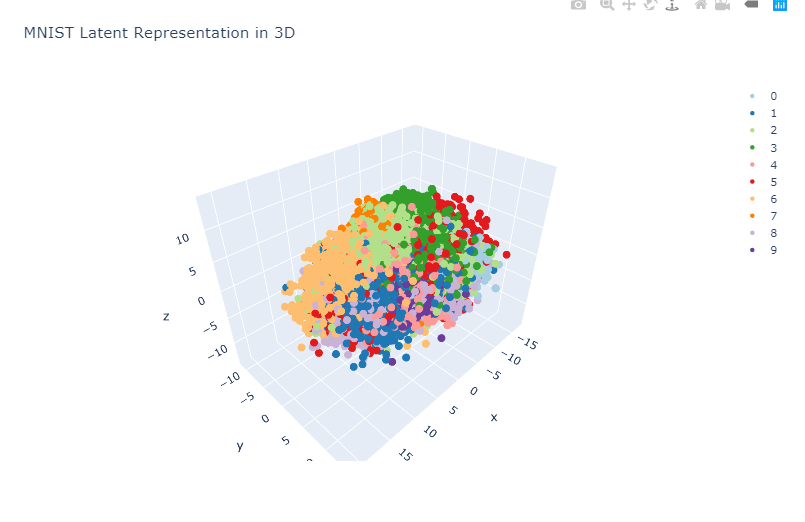

In [2]:
from IPython.display import Image
Image("latent.png")

In [0]:
#Visualization of the downloaded sample from PART1

In [0]:
#Dowloaded sample from part1.....
part1 = pd.read_csv('data/df.csv')

In [0]:
S_pca_ = np.array(part1)

In [0]:
#y = np.concatenate((y_train,y_test),axis=0)
digits_3d = pd.DataFrame({
    'x': S_pca_[:, 0], 
    'y': S_pca_[:, 1], 
    'z': S_pca_[:, 2],
    'label': y_train[1:],
})
colors = cl.scales['10']['qual']['Paired']
data = []
for i in range(10):
    x = digits_3d[digits_3d['label'].astype('int') == i]['x']
    y = digits_3d[digits_3d['label'].astype('int') == i]['y']
    z = digits_3d[digits_3d['label'].astype('int') == i]['z']
    color = colors[i]
    trace = {
        'name': str(i),
        'x': x,
        'y': y,
        'z': z,
        'type': 'scatter3d',
        'mode': 'markers',
        'marker': {
            'size': 5,
            'color': color 
        }
    }
    data.append(trace)

layout = go.Layout(
    title='Visualization of the downloaded sample from part1(Manifold)',
    width=900,
    height=600
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, show_link = False)

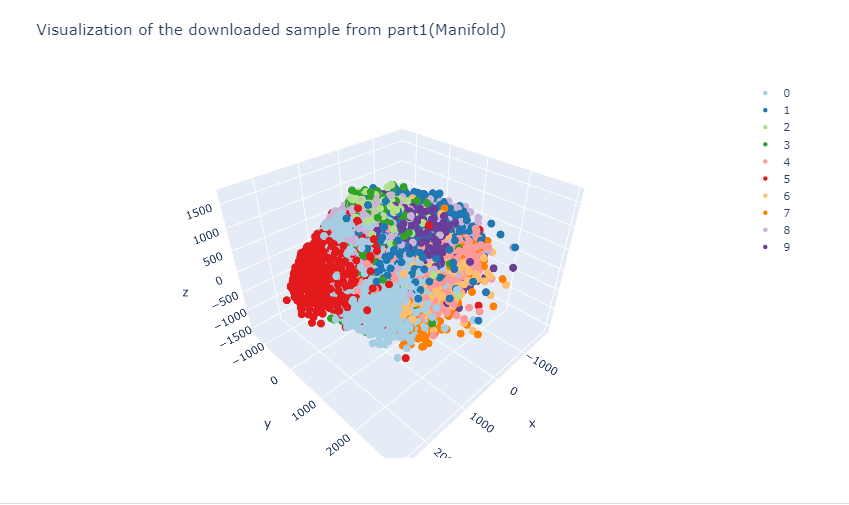

In [3]:
from IPython.display import Image
Image("manifold.png")

#### 2.4 Get the classification accuracy for the latest features. Use the `KNN` classifier with any hyperparameters you'll choose. Write a couple of sentences comparing the results of `manifold learning` and ` AE`. 

In [0]:
df.shape

(70000, 40)

In [0]:
latent_train = df[:60000,:]
latent_train.shape

(60000, 40)

In [0]:
latent_test = df[60000:,:]
latent_test.shape

(10000, 40)

In [0]:
### BEGIN Solution
# >>> your solution here <<<
KNN_clf = KNeighborsClassifier(n_neighbors= 15,weights='distance', n_jobs=-1)
KNN_clf.fit(latent_train, y_train)
# >>> your solution here <<<
### END Solution

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=15, p=2,
                     weights='distance')

In [0]:
print("Accuracy on test data: ", KNN_clf.score(latent_test,y_test))

Accuracy on test data:  0.9092


- From the experiemntal result, the Manifold Learning gave a better performance (in terms of accuracy) compared to the AE implemented here 

### BONUS: Sampling from latent space. (3 points)

Imagine, that you want to generate images, using you AE. To do that, you need to sample from the latent space and then decode the result. Of course, we do not know the exact distribution of the latent space. Therefore, let us assume that latent space distribution is Gaussian:

* Encode all the training images into the latent space
* Calculate mean and covariance matrix ($\mu$ and $\Sigma$)
* Sample  $z$ from the $\mathcal{N}(\mu, \Sigma)$
* Decode $z$ from the previous step to obtain an image

Using the procedure described above, sample 10 images and plot them (they should be similar to those of the initial dataset)

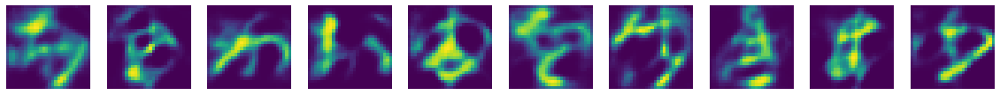

In [0]:
### BEGIN Solution

# >>> your solution here <<<

### END Solution

**Yeah, so you can get more than `100%` for the homework, good luck!**